In [75]:
import torch
import torch.nn as nn
from torch.utils.data import DataLoader,TensorDataset
from torch.utils.data import Dataset, DataLoader
import pandas as pd
from sklearn.preprocessing import LabelEncoder, MinMaxScaler
from torcheval.metrics import R2Score


In [76]:
import time
import os
import numpy as np
from sklearn import metrics

In [77]:
torch.cuda.empty_cache()

In [78]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

In [79]:
def moving_average(data, window_size):
    if data.ndim == 1:
        window = np.ones(window_size) / window_size
        return np.convolve(data, window, mode='same')
    elif data.ndim == 2:
        smoothed_data = np.zeros_like(data)
        window = np.ones(window_size) / window_size
        for i in range(data.shape[1]):
            smoothed_data[:, i] = np.convolve(data[:, i], window, mode='same')
        return smoothed_data

def downsample(data, factor):
    if data.ndim == 1:
        return data[::factor]
    elif data.ndim == 2:
        return data[::factor, :]

In [80]:
class Dataset_Epic(Dataset):
    def __init__(self, train_path=None,test_path=None,flag="train",num_T=1):
        mms = MinMaxScaler(feature_range=(0, 1))
        self.flag = flag
        self.features=['ECG_Rate', 
                       'EDA_Tonic',
                       'EDA_Phasic',
                       'EMG_Amplitude_coru',
                       'EMG_Amplitude_trap',
                       'EMG_Amplitude_zygo',
                       'PPG_Rate',
                       'Skt',
                       # 'Video'
                      ]
        self.labels=["valence","arousal"]
        
        self.train_df = pd.DataFrame()
        self.num_T = num_T
        self.test_df = pd.DataFrame()
        if self.flag == 'train':
            if not train_path.endswith("/"):
                train_path += "/"
            if os.path.isfile(train_path):
                self.train_df = pd.read_csv(train_path)
            
            if os.path.isdir(train_path):
                for (dirpath, dirnames, filenames) in os.walk(train_path):
                    for filename in filenames:
                        self.train_df = pd.concat([self.train_df,pd.read_csv(f"{dirpath}{filename}")],ignore_index=True)
            
            self.train_df['groups'] = self.train_df['ID'].astype(str)
            self.groups = self.train_df['groups'].values
            self.train_data = mms.fit_transform(self.train_df.loc[:,self.features].astype(np.float32).values)
            self.train_label = self.train_df.loc[:,self.labels].astype(np.float32).values
        if self.flag == 'test':
            
            if not test_path.endswith("/"):
                test_path += "/"

            if os.path.isfile(test_path):
                self.test_df = pd.read_csv(test_path)

            if os.path.isdir(test_path):
                for (dirpath, dirnames, filenames) in os.walk(test_path):
                    for filename in filenames:
                        self.test_df = pd.concat([self.test_df,pd.read_csv(f"{dirpath}{filename}")[self.features+self.labels]],ignore_index=True)
                        
            
            self.test_data = mms.fit_transform(self.test_df.loc[:,self.features].astype(np.float32).values)
            # self.test_data = moving_average(self.test_data,100)
            # self.test_data = downsample(self.test_data,100)
            
            self.test_label = self.test_df.loc[:,self.labels].astype(np.float32).values
            # self.test_label = moving_average(self.test_label,100)
            # self.test_label = downsample(self.test_label,100)

    def __getitem__(self, index):
        x = None
        y = None
        if self.flag == 'train':
            x = self.train_data[index:index + self.num_T]
            y = self.train_label[index+self.num_T-1]
        elif self.flag == 'test':
            x = self.test_data[index:index + self.num_T]
            y = self.test_label[index+self.num_T-1]
        
        return x, y

    def __len__(self):
        # minus the label length
         # minus the label length
        if self.flag == 'train':
            return len(self.train_data) - self.num_T
        elif self.flag == 'test':
            return len(self.test_data) - self.num_T

In [115]:
test = Dataset_Epic(test_path="../ID_20_2hz_test_dynamic_features_lagstep60",flag="test",num_T=1)

In [116]:
test_dataloader = DataLoader(
    test,
    batch_size=16,
    shuffle=False,
    num_workers=0,
    drop_last=False,
    pin_memory=True,
)

In [117]:
class LSTMNet(nn.Module):
    def __init__(self, input_size, hidden_size, num_layers,dropout_rate,num_T=20):
        super(LSTMNet, self).__init__()
        self.lstm = nn.LSTM(input_size, hidden_size, num_layers, batch_first=True,dropout=dropout_rate)
        #self.fc = nn.Linear(hidden_size, 2)  # Output a single value for each time step
        self.fc = nn.Sequential(
            nn.Linear(hidden_size*num_T, 2),
        )

    def forward(self, x):
        # x is expected to have shape (batch_size, numFeatures, num_T)
        # Permute x to (batch_size, num_T, numFeatures) for LSTM
        
        #x = x.permute(0, 2, 1)
        batch_size, num_T, num_features = x.shape
        

        # Initialize hidden state and cell state on the same device as input x
        h0 = torch.zeros(self.lstm.num_layers, x.size(0), self.lstm.hidden_size).to(x.device)
        c0 = torch.zeros(self.lstm.num_layers, x.size(0), self.lstm.hidden_size).to(x.device)

        # Forward pass through LSTM layer
        out, _ = self.lstm(x, (h0, c0))
        
        # Pass the outputs through the fully connected layer to predict a value for each time step
        out = out.reshape(batch_size,-1)
        out = self.fc(out)  # out has shape (batch_size, num_T, 1)
        
        # Remove the last dimension, resulting in (batch_size, num_T)
        out = out.squeeze(-1)

        return out




In [118]:
best_model = torch.load('./best_model_dropout_l2_nooverlap_80_ID_tanming_cross_val_no_dyn_no_video_id.pt',weights_only=False)


In [113]:
print(best_model.state_dict())

OrderedDict([('lstm.weight_ih_l0', tensor([[ 0.1776,  0.6675,  0.0371,  ...,  0.2218,  0.0766,  0.0827],
        [ 0.4812,  0.5888, -0.0515,  ..., -0.0339,  0.2838, -0.1313],
        [ 0.2103,  0.4700,  0.0930,  ..., -0.0319,  0.2419,  0.2379],
        ...,
        [ 0.4303,  0.8383, -0.0163,  ...,  0.2074,  0.2372, -0.1837],
        [ 0.0945,  0.6065,  0.1763,  ..., -0.0622,  0.1889,  0.3332],
        [ 0.1916,  0.7303,  0.2060,  ..., -0.0266,  0.2733,  0.2292]],
       device='cuda:0')), ('lstm.weight_hh_l0', tensor([[-0.1570,  0.0578,  0.1234,  ..., -0.0415, -0.0627, -0.0156],
        [-0.1022,  0.1048,  0.0934,  ...,  0.0084, -0.0954, -0.1124],
        [ 0.0757,  0.0523, -0.0850,  ...,  0.1144,  0.0982, -0.0219],
        ...,
        [-0.0866, -0.0774, -0.0429,  ...,  0.1118, -0.1207, -0.1032],
        [-0.1161,  0.0899,  0.0658,  ..., -0.1387, -0.0042,  0.0301],
        [ 0.0071, -0.1425, -0.1128,  ...,  0.0444,  0.1052, -0.0797]],
       device='cuda:0')), ('lstm.bias_ih_l0', ten

In [114]:
epoch_loss = 0.0
criterion = nn.MSELoss()
predictions = []
actuals = []
metric = R2Score()
for index, (x, y) in enumerate(test_dataloader):
    x, y = x.to(device), y.to(device)
    outputs = best_model(x)
    predictions.extend(outputs.detach().cpu().numpy())
    actuals.extend(y.detach().cpu().numpy())
    loss = criterion(outputs, y)
    metric.update(outputs,y)

    epoch_loss += loss.item()
avg_loss = epoch_loss / len(test_dataloader)
r2 = metric.compute()  
print(f"lost {avg_loss}")
print(f"r2 {r2}")


RuntimeError: input.size(-1) must be equal to input_size. Expected 8, got 9

In [42]:
predictions = pd.DataFrame(predictions)
actuals = pd.DataFrame(actuals)

In [43]:
print(predictions)

              0         1
0      6.454001  5.493973
1      6.511465  5.581899
2      6.475599  5.527662
3      6.465816  5.514967
4      6.454456  5.497197
...         ...       ...
15218  3.969521  6.358457
15219  3.969573  6.352182
15220  3.968167  6.369443
15221  3.965127  6.392378
15222  3.963803  6.406521

[15223 rows x 2 columns]


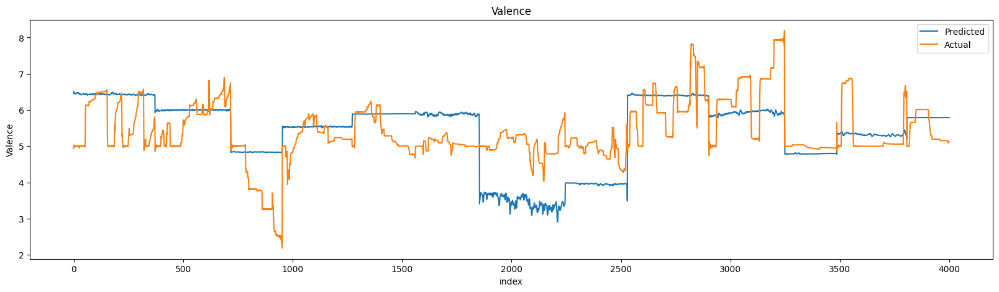

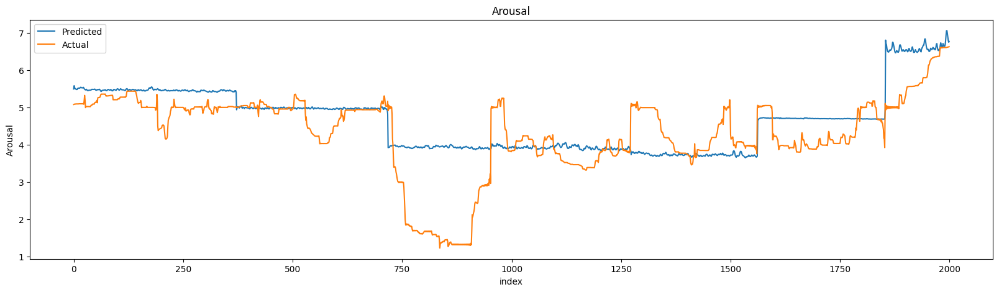

In [44]:
import matplotlib.pyplot as plt
plt.figure(figsize=(20, 5))
plt.plot(predictions[0:4000][0], label='Predicted')
plt.plot(actuals[0:4000][0], label='Actual')
plt.xlabel('index')
plt.ylabel('Valence')
plt.legend()
plt.title('Valence')
plt.show()

plt.figure(figsize=(20, 5))
plt.plot(predictions[0:2000][1], label='Predicted')
plt.plot(actuals[0:2000][1], label='Actual')
plt.xlabel('index')
plt.ylabel('Arousal')
plt.legend()
plt.title('Arousal')
plt.show()

In [45]:
Predict_Valence = []
Predict_Arousal = []
for p in predictions[0]:
    Predict_Valence.append(p)
for p in predictions[1]:
    Predict_Arousal.append(p)
predictions_df = pd.DataFrame({"Predict_Valence":Predict_Valence, "Predict_Arousal": Predict_Arousal})

In [46]:
test_df = pd.DataFrame()
for (dirpath, dirnames, filenames) in os.walk("./ID_20_2hz_test_dynamic_features_lagstep60/"):
    for filename in filenames:
        test_df = pd.concat([test_df,pd.read_csv(f"{dirpath}{filename}")],ignore_index=True)
                        

In [47]:
test_df = pd.concat([test_df,predictions_df],axis="columns")
test_df[['ID', 'Video','Predict_Valence','Predict_Arousal','valence','arousal']].to_csv("./plotting/fourier_actual_pred.csv")

In [22]:
group_by_video = test_df.groupby("Video")

c:\users\yuki\pyenv\fgnn\lib\site-packages\pandas\plotting\_matplotlib\core.py:509: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = self.plt.figure(figsize=self.figsize)


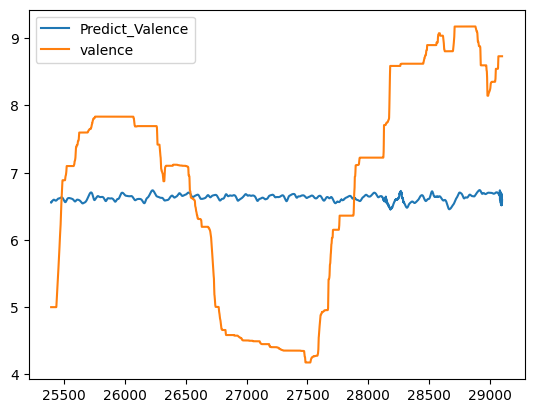

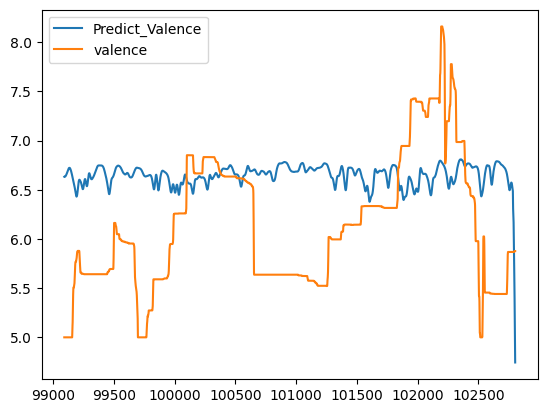

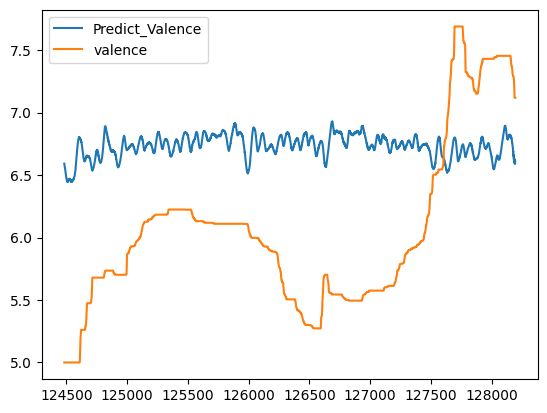

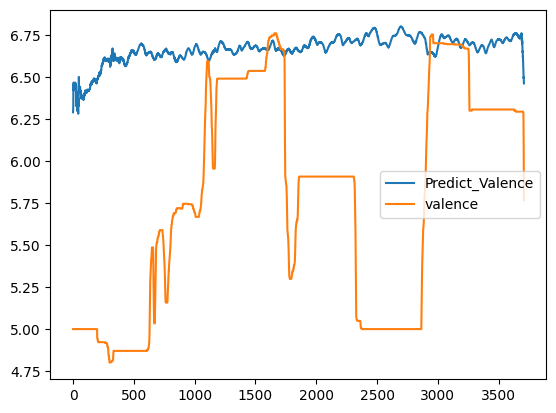

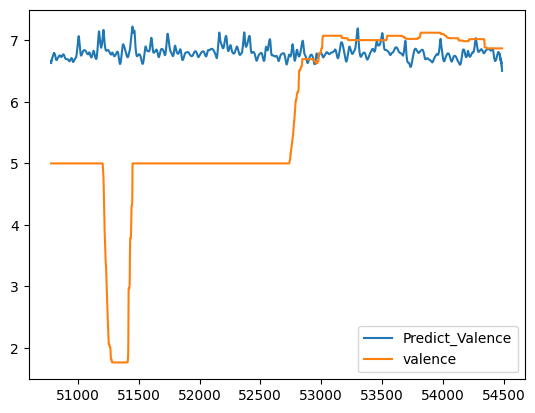

...

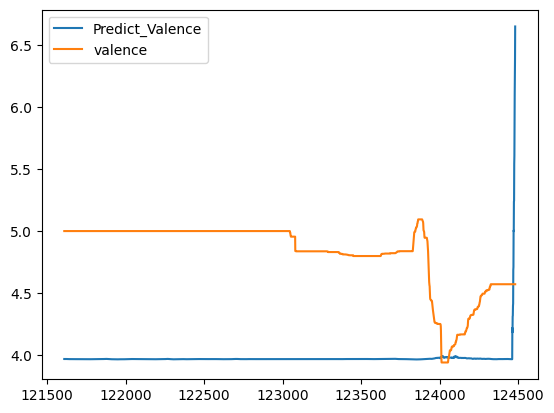

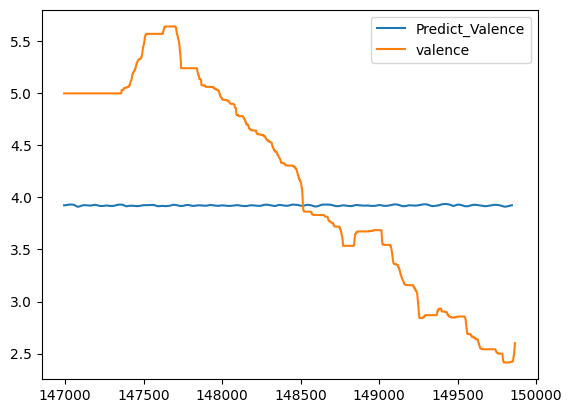

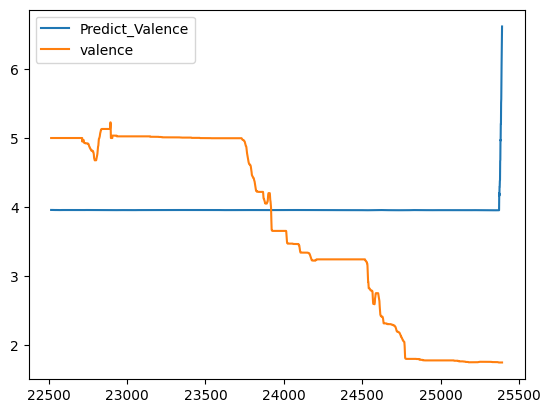

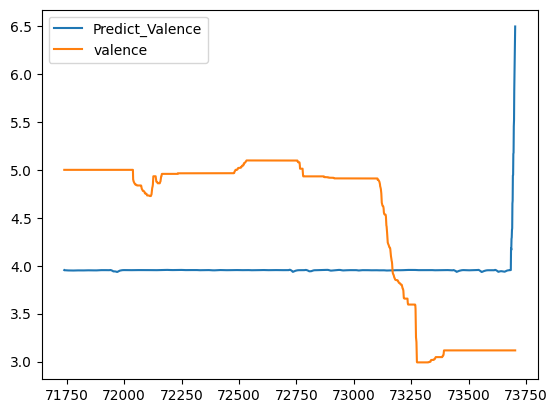

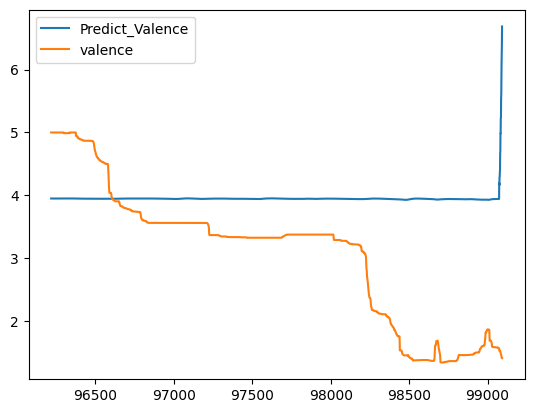

In [30]:
for Video, group in group_by_video:
    group_by_ID = group.groupby("ID")
    for ID, ID_group in group_by_ID:
        ID_group[["Predict_Valence", "valence"]].plot(kind="line").get_figure().savefig(f"./predictions/video-lstm-slide-win-20-ID-numT-hyperopt/Valence/Video_{Video}_ID_{ID}_Valence.png")

c:\users\yuki\pyenv\fgnn\lib\site-packages\pandas\plotting\_matplotlib\core.py:509: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = self.plt.figure(figsize=self.figsize)


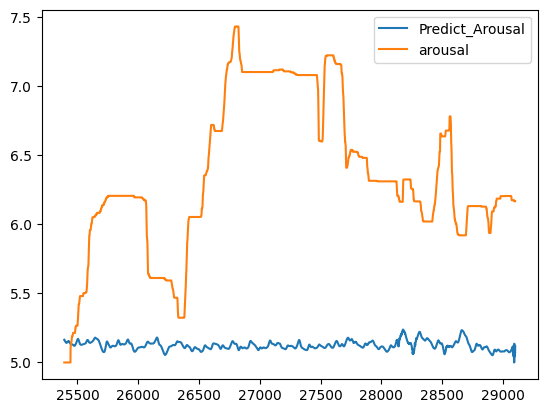

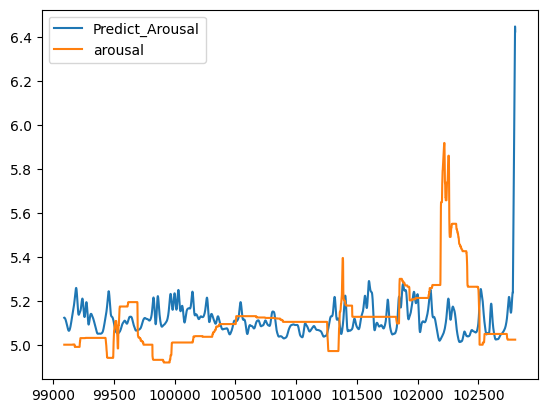

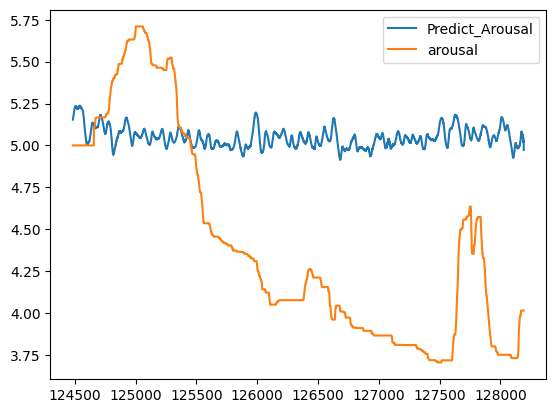

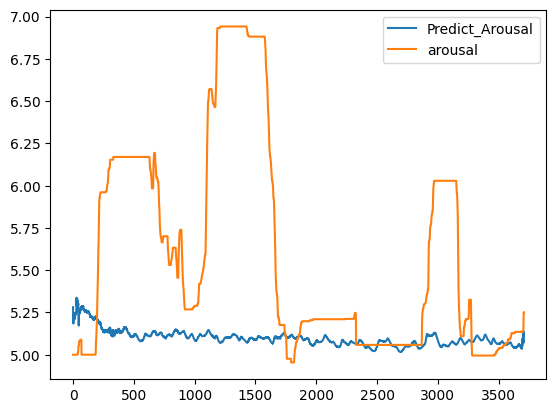

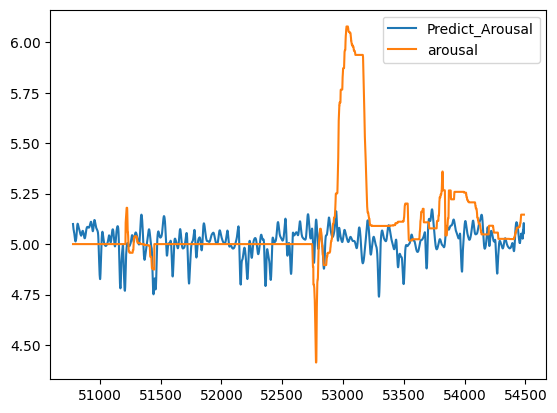

...

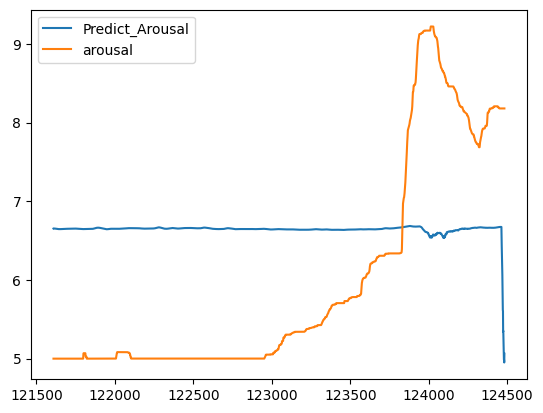

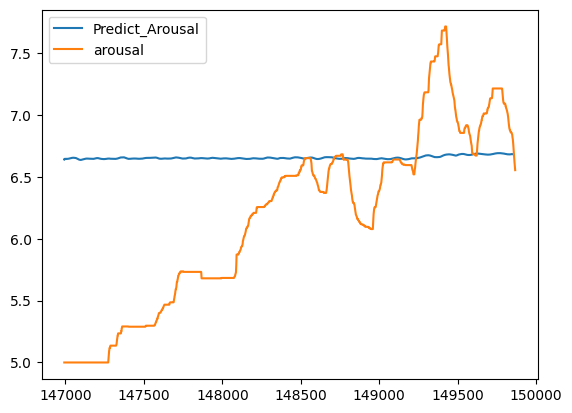

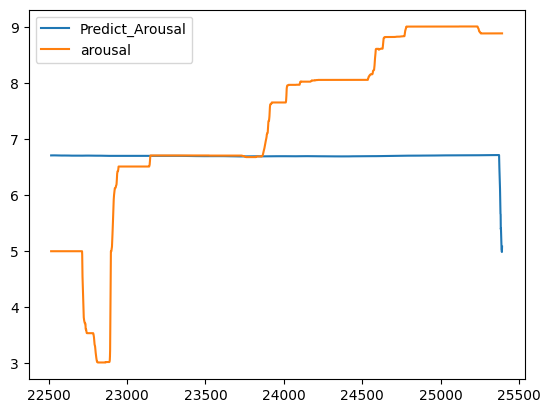

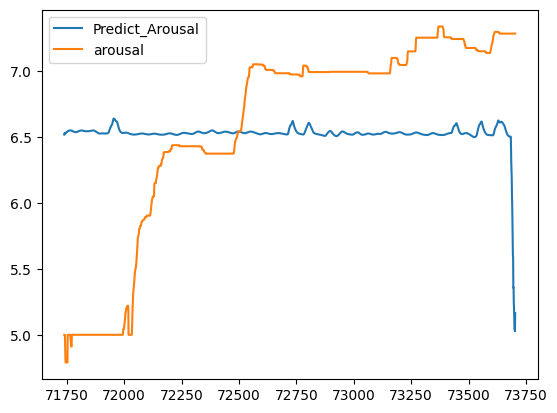

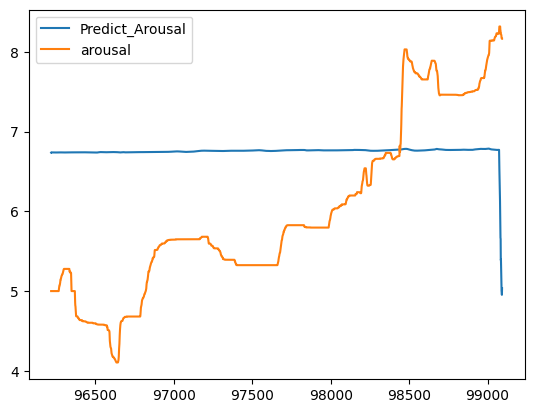

In [31]:
for Video, group in group_by_video:
    group_by_ID = group.groupby("ID")
    for ID, ID_group in group_by_ID:
        ID_group[["Predict_Arousal", "arousal"]].plot(kind="line").get_figure().savefig(f"./predictions/video-lstm-slide-win-50-ID/Arousal/Video_{Video}_ID_{ID}_Arousal.png")

In [99]:
# Define a Transformer model
class TransformerModel(nn.Module):
    def __init__(self, num_Features, num_heads, num_layers, dim_feedforward, num_outputs, dropout):
        super(TransformerModel, self).__init__()
        self.encoder_layer = nn.TransformerEncoderLayer(
            d_model=num_Features,
            nhead=num_heads,
            dim_feedforward=dim_feedforward,
            dropout=dropout,
            batch_first=True
        )
        self.transformer_encoder = nn.TransformerEncoder(self.encoder_layer, num_layers=num_layers)
        self.fc = nn.Linear(num_Features, num_outputs)

    def forward(self, src):
        # src is expected to have shape (batch_size, num_T, num_Features)
        output = self.transformer_encoder(src)  # Output shape (batch_size, num_T, num_features)
        output = self.fc(output)                # Output shape (batch_size, num_T, num_outputs)
        output = output.squeeze(2)              # Remove the last dimension, shape (batch_size, num_T)

        
        return output



In [100]:
epochs=8
model = TransformerModel(
        num_Features=len(train.features),
        num_heads=4,
        num_layers=4,
        dim_feedforward=176,
        num_outputs=2,
        dropout=0.10433022439244555
).to(device)  # Move model to the specified device

    # Define loss and optimizer
criterion = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=0.00654794205163379)

least_lost = 5.0
best_mode = None
# Training loop
model.train()
for epoch in range(epochs):
    epoch_loss = 0.0
    for index, (x, y) in enumerate(train_dataloader):
        x, y = x.to(device), y.to(device)  # Move data to device

        optimizer.zero_grad()
        outputs = model(x)
        loss = criterion(outputs, y)
        loss.backward()
        optimizer.step()
        epoch_loss += loss.item()

    avg_epoch_loss = epoch_loss / len(train_dataloader)
    if avg_epoch_loss < least_lost:
        best_model = model
        least_lost = avg_epoch_loss
    print(f'Epoch [{epoch + 1}/{epochs}], Loss: {avg_epoch_loss:.4f}')
print(least_lost)
print(best_model)

Epoch [1/8], Loss: 2.1081
Epoch [2/8], Loss: 2.0217
Epoch [3/8], Loss: 2.0057
Epoch [4/8], Loss: 2.0175
Epoch [5/8], Loss: 2.0152
Epoch [6/8], Loss: 2.0019
Epoch [7/8], Loss: 1.9995
Epoch [8/8], Loss: 1.9974
1.9974187769327838
TransformerModel(
  (encoder_layer): TransformerEncoderLayer(
    (self_attn): MultiheadAttention(
      (out_proj): NonDynamicallyQuantizableLinear(in_features=8, out_features=8, bias=True)
    )
    (linear1): Linear(in_features=8, out_features=176, bias=True)
    (dropout): Dropout(p=0.10433022439244555, inplace=False)
    (linear2): Linear(in_features=176, out_features=8, bias=True)
    (norm1): LayerNorm((8,), eps=1e-05, elementwise_affine=True)
    (norm2): LayerNorm((8,), eps=1e-05, elementwise_affine=True)
    (dropout1): Dropout(p=0.10433022439244555, inplace=False)
    (dropout2): Dropout(p=0.10433022439244555, inplace=False)
  )
  (transformer_encoder): TransformerEncoder(
    (layers): ModuleList(
      (0-3): 4 x TransformerEncoderLayer(
        (sel

In [101]:
epoch_loss = 0.0
criterion = nn.MSELoss()
predictions = []
for index, (x, y) in enumerate(test_dataloader):
    outputs = best_model(x)
    predictions.append(outputs.detach().cpu().numpy())
    loss = criterion(outputs, y)

    epoch_loss += loss.item()
avg_loss = epoch_loss / len(train_dataloader)

    
    
print(f"lost {avg_loss}")

lost 1.7845355327062016


In [102]:
predictions = np.concatenate(predictions)

In [103]:
Predict_Valence = []
Predict_Arousal = []
for p in predictions:
    Predict_Valence.append(p[0][0])
    Predict_Arousal.append(p[0][1])
predictions_df = pd.DataFrame({"Predict_Valence":Predict_Valence, "Predict_Arousal": Predict_Arousal})

In [104]:
test_df = pd.DataFrame()
for (dirpath, dirnames, filenames) in os.walk("./test_data/full/"):
    for filename in filenames:
        test_df = pd.concat([test_df,pd.read_csv(f"{dirpath}{filename}")],ignore_index=True)

In [105]:
test_df = pd.concat([test_df,predictions_df],axis="columns")

In [106]:
group_by_video = test_df.groupby("Video")

c:\users\yuki\appdata\local\programs\python\python38\lib\site-packages\pandas\plotting\_matplotlib\core.py:509: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = self.plt.figure(figsize=self.figsize)


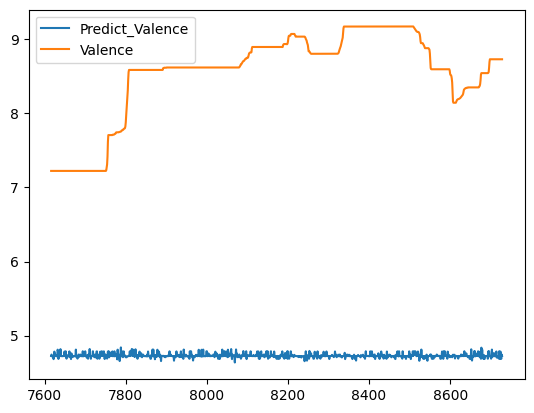

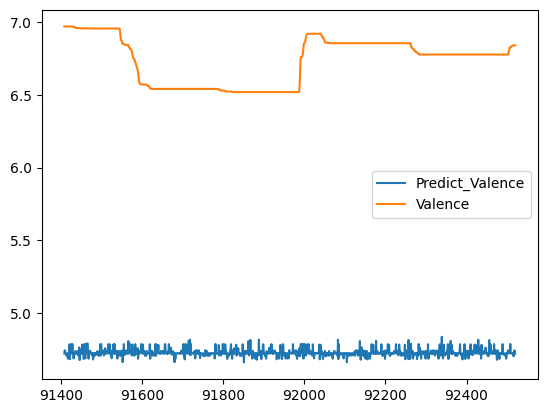

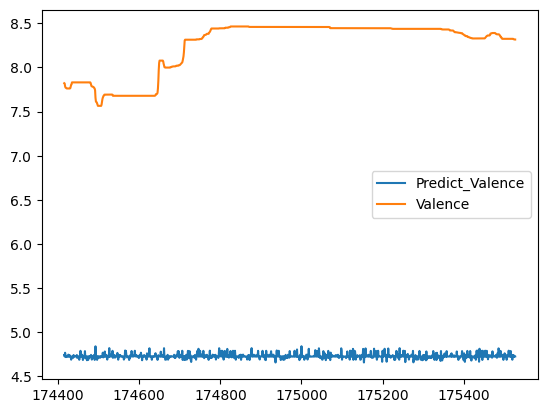

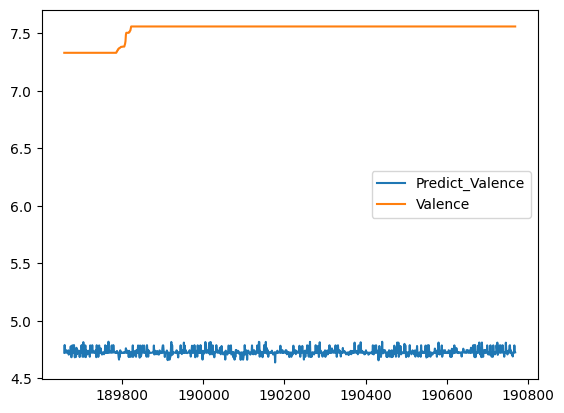

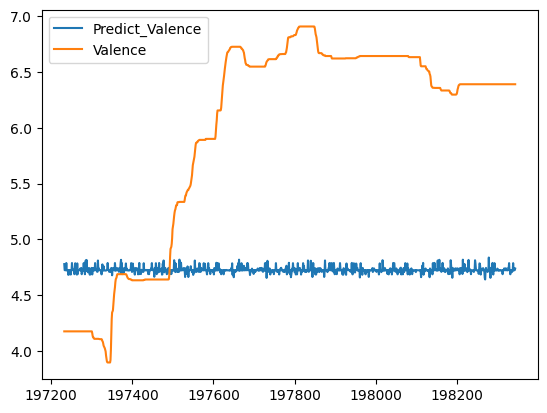

...

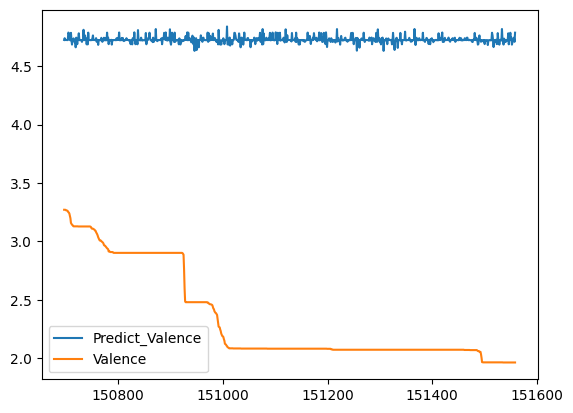

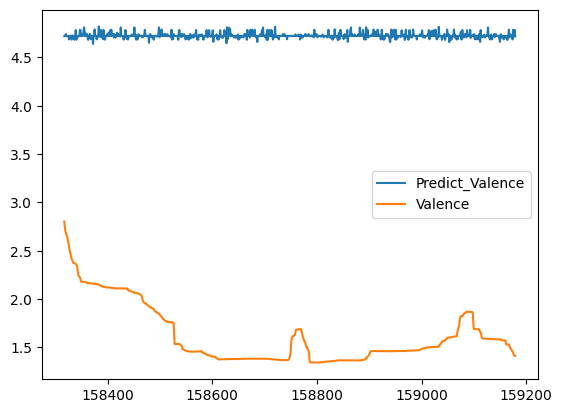

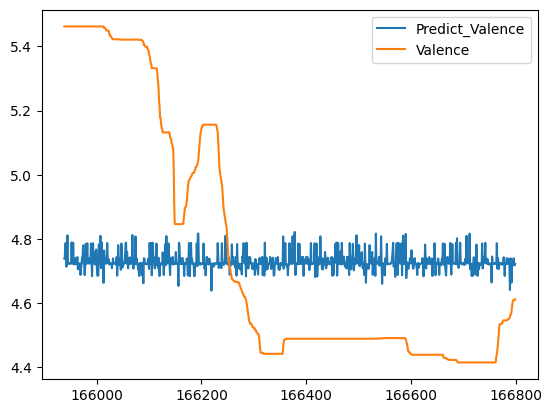

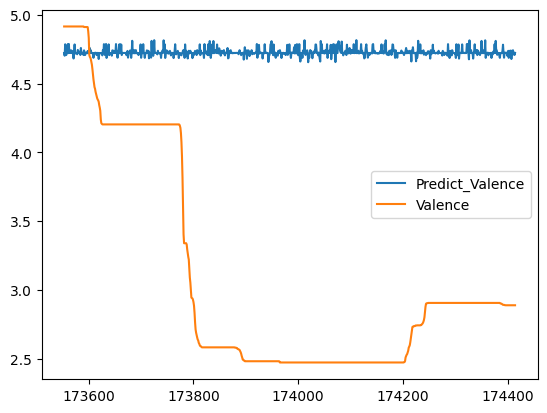

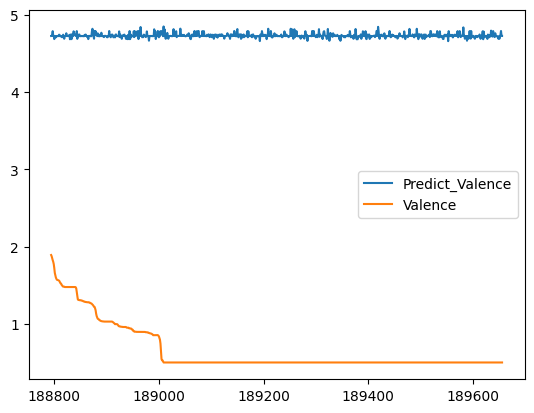

In [108]:
for Video, group in group_by_video:
    group_by_ID = group.groupby("ID")
    for ID, ID_group in group_by_ID:
        ID_group[["Predict_Valence", "Valence"]].plot(kind="line").get_figure().savefig(f"./predictions/transformer/Valence/Video_{Video}_ID_{ID}_Valence.png")

c:\users\yuki\appdata\local\programs\python\python38\lib\site-packages\pandas\plotting\_matplotlib\core.py:509: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = self.plt.figure(figsize=self.figsize)


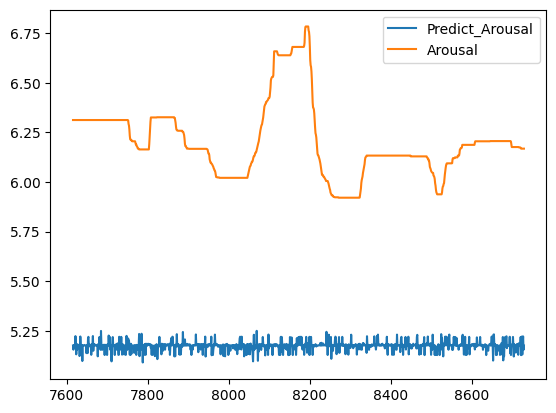

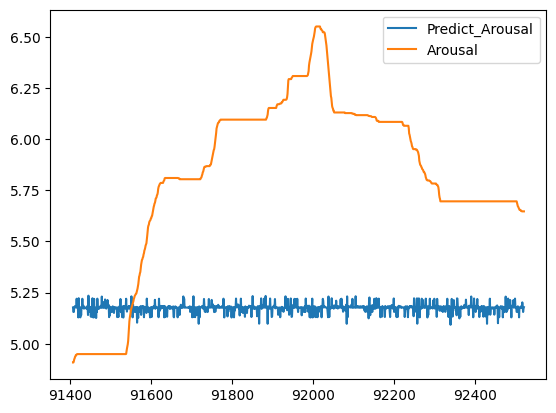

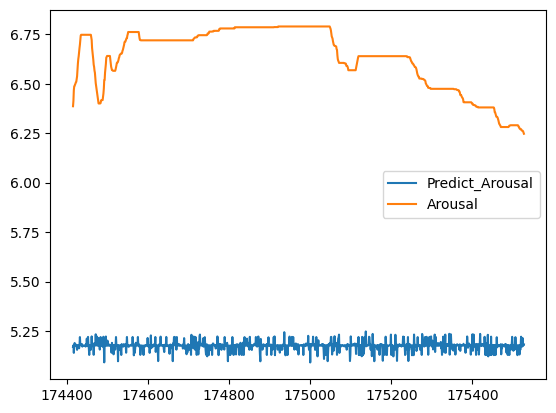

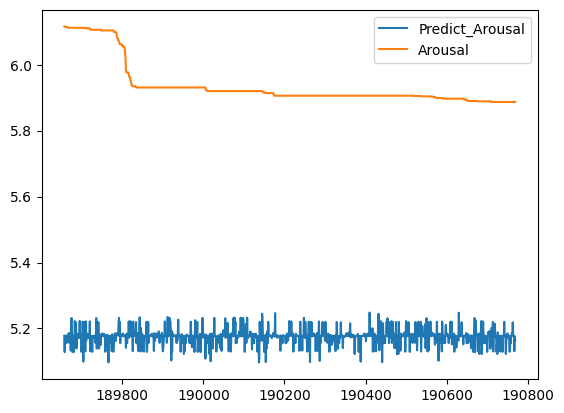

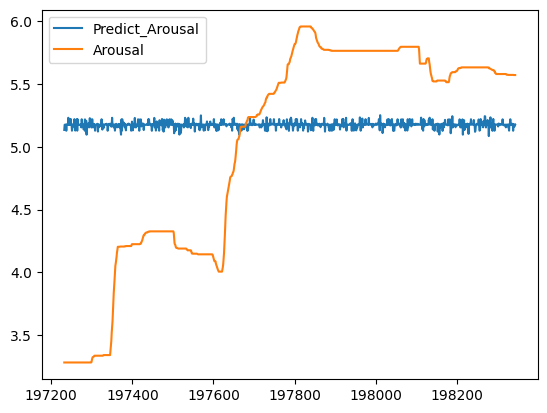

...

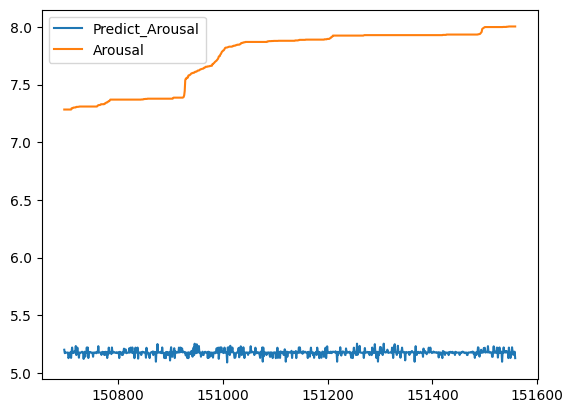

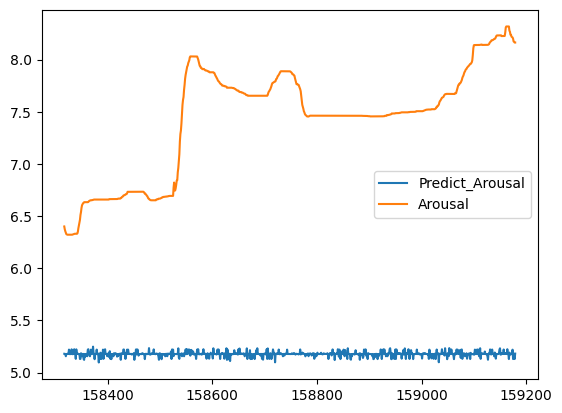

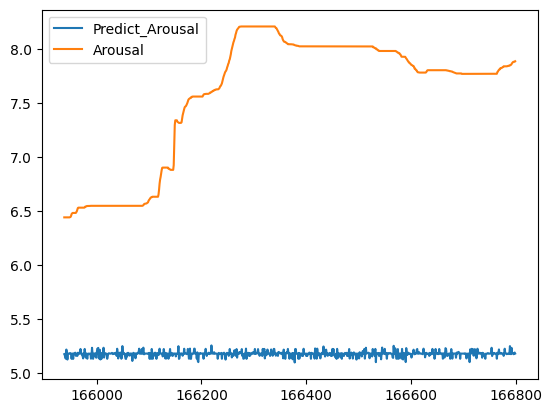

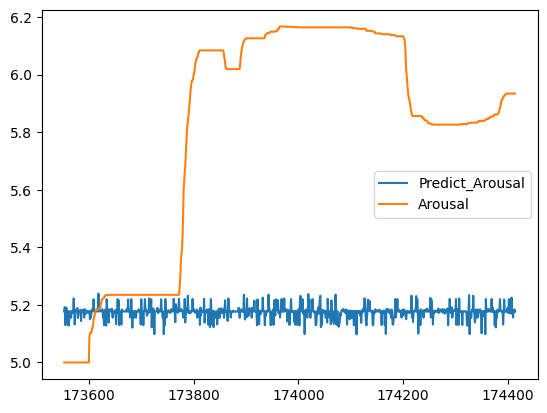

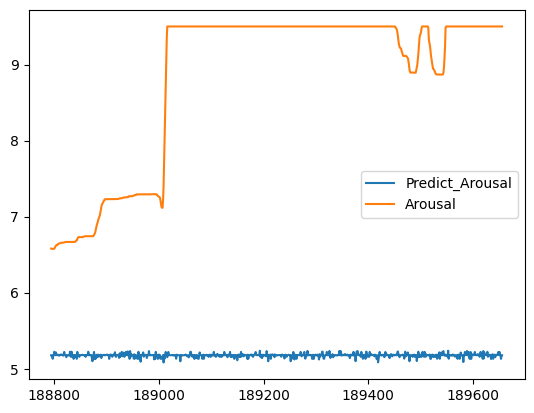

In [109]:
for Video, group in group_by_video:
    group_by_ID = group.groupby("ID")
    for ID, ID_group in group_by_ID:
        ID_group[["Predict_Arousal", "Arousal"]].plot(kind="line").get_figure().savefig(f"./predictions/transformer/Arousal/Video_{Video}_ID_{ID}_Arousal.png")